# **Análise da base de dados *'Crime Data from 2020 to Present'* 📄📊**
---
## 1. Preparo das ferramentas necessárias para análise

### 1.1 Bibliotecas

Antes de iniciar a análse, é feita a importação de bibliotecas que serão utilizadas posteriormente. A seguir, uma tabela com cada biblioteca, uma breve descrição e sua utilidade na análise:  

|Nome |Descrição|Utilidade|
|:---:|:-------:|:-------:|
|`pandas`|Oferece estruturas de dados (Series e DataFrames) e funções para data wrangling|Abertura, armazenamento e tratamento da base de crimes|
|`locale`|Biblioteca *built-in* que permite a definição de padrões baseados em localidade e idioma|Mudança da regionalização para 'pt_BR'|
|`matplotlib`|Dedicada à criação de elementos visuais, como gráficos de linha, barras, dispersão, histogramas etc. O `pyplot` é um módulo dessa biblioteca que fornece uma interface simples para a criação dos gráficos|Uso de `pyplot` para criar figuras e personalizar os gráficos|
|`seaborn`|Baseada na `matplotlib`, permite a criação de gráficos estatísticos estilosos|Criação dos gráficos (*plots*)|
|`folium`|Oferece suporte para construção de mapas interativos usando `Leaflet.js`|Construção de mapas de calor usando as classes `Map` e `Heatmap`|
|`scipy`|Voltada para cálculos científicos e técnicos, fornece funções avançadas para álgebra linear, estatística, integração, interpolação, otimização, etc.|Testes de normalidade empregando o módulo `stats`|

In [29]:
import pandas as pd
import locale
import matplotlib.pyplot as plt
import seaborn as sns
import folium
from folium.plugins import HeatMap
from scipy import stats

locale.setlocale(locale.LC_ALL, 'pt_BR')

'pt_BR'

### 1.2. Importação da base

Em seguida, foi feita a importação da base para o ambiente.  

A primeira etapa para importar a base foi definir o seu caminho, que foi armazenado na constante `CAMINHO_BASE_CRIMES`:

(insira o caminho da base no valor da variável)

In [30]:
CAMINHO_BASE_CRIMES = r""
CAMINHO_METADADOS_CRIMES = 'mock_data/metadados_crime_data.csv'

Após isso, usando o módulo `read_csv()` da pandas, lê-se o conteúdo da base CSV, armazenando-o no DataFrame `df_crimes`. Observe o argumento `dtype=str`, informando à pandas para ler os dados como strings:

In [ ]:
df_crimes = pd.read_csv(CAMINHO_BASE_CRIMES, dtype=str)
df_crimes_metadados = pd.read_csv(CAMINHO_METADADOS_CRIMES, dtype=str, index_col='Column Name')

### 1.3. Tratamento

Por fim, foi feito o tratamento do DataFrame df_crimes, de acordo com o seguinte procedimento:

1. Copiar o DataFrame original para outro DataFrame chamado `df_crimes_tratado`:

In [4]:
df_crimes_tratado = df_crimes.copy()

2. Remover duplicatas e registros nulos de `df_crimes_tratado`:

In [5]:
df_crimes_tratado = df_crimes_tratado.drop_duplicates()
df_crimes_tratado = df_crimes_tratado.dropna(how='all')

3. Configurar a coluna DR_NO (*Division of Records Number* - Número de Divisão de Registros) para servir como index de `df_crimes_tratado`, aproveitando para ordenar o DataFrame em ordem crescente usando esse campo:

In [6]:
df_crimes_tratado = df_crimes_tratado.set_index('DR_NO')
df_crimes_tratado = df_crimes_tratado.sort_index()

4. Converter tipos de cada coluna, determinando as variáveis numéricas discretas, numéricas contínuas e categóricas:

In [7]:
colunas_discretas = ['AREA', 'Crm Cd', 'Part 1-2', 'Vict Age', 'Premis Cd', 'Weapon Used Cd', 'Crm Cd 1', 'Crm Cd 2', 'Crm Cd 3', 'Crm Cd 4']

colunas_continuas = ['LAT', 'LON']

for column in df_crimes_tratado.columns:
    if column in colunas_discretas:
        df_crimes_tratado[column] = df_crimes_tratado[column].astype('Int64')
    elif column in colunas_continuas:
        df_crimes_tratado[column] = df_crimes_tratado[column].astype(float)
    else:
        df_crimes_tratado[column] = df_crimes_tratado[column].astype('category')

5. Converter colunas de datas para o tipo correto:

In [8]:
df_crimes_tratado['Date Rptd'] = pd.to_datetime(df_crimes_tratado['Date Rptd'], format="%m/%d/%Y", exact=False)
df_crimes_tratado['DATE OCC'] = pd.to_datetime(df_crimes_tratado['DATE OCC'], format="%m/%d/%Y", exact=False)

6. Criar as colunas `['ANO OCC', 'MES OCC', 'DIA OCC', 'DIA SEMANA OCC', 'HORA OCC']` para uso posterior na análise:

In [9]:
df_crimes_tratado['ANO OCC'] = df_crimes_tratado['DATE OCC'].dt.year
df_crimes_tratado['MES OCC'] = df_crimes_tratado['DATE OCC'].dt.month
df_crimes_tratado['DIA OCC'] = df_crimes_tratado['DATE OCC'].dt.day
df_crimes_tratado['DIA SEMANA OCC'] = df_crimes_tratado['DATE OCC'].dt.day_of_week
df_crimes_tratado['HORA OCC'] = df_crimes_tratado['TIME OCC'].str[:2].astype(int)

---

## 2. Análise

Após a configuração das ferramentas necessárias, realiza-se a análise da base tratada.

### 2.1. Análises gerais

A primeira etapa consiste em análises gerais, baseadas na visualização dos dados, na descrição dos campos e nos metadados da base.

#### 2.1.1. Visualização

A visualização da base foi feita por meio de:

1. Metadados da base:

In [35]:
df_crimes_metadados

,Description,API Field Name,Data Type
Column Name,,,
DR_NO,Division of Records Number: Official file numb...,dr_no,Text
Crm Cd Desc,Defines the Crime Code provided.,crm_cd_desc,Text
Mocodes,\nModus Operandi: Activities associated with t...,mocodes,Text
Vict Age,Two character numeric,vict_age,Text
Vict Sex,F - Female M - Male X - Unknown,vict_sex,Text
Vict Descent,Descent Code: A - Other Asian B - Black C - Ch...,vict_descent,Text
Premis Cd,"The type of structure, vehicle, or location wh...",premis_cd,Number
Premis Desc,Defines the Premise Code provided.,premis_desc,Text
Weapon Used Cd,The type of weapon used in the crime.,weapon_used_cd,Text


2. Método `head()`:

In [10]:
df_crimes_tratado.head()

,Date Rptd,DATE OCC,TIME OCC,AREA,AREA NAME,Rpt Dist No,Part 1-2,Crm Cd,Crm Cd Desc,Mocodes,...,Crm Cd 4,LOCATION,Cross Street,LAT,LON,ANO OCC,MES OCC,DIA OCC,DIA SEMANA OCC,HORA OCC
DR_NO,,,,,,,,,,,,,,,,,,,,,
010304468,2020-01-08,2020-01-08,2230,3,Southwest,0377,2,624,BATTERY - SIMPLE ASSAULT,0444 0913,...,<NA>,1100 W 39TH PL,NaN,34.0141,-118.2978,2020,1,8,2,22
0817,2020-09-20,2020-09-19,1700,17,Devonshire,1777,1,510,VEHICLE - STOLEN,NaN,...,<NA>,9100 RUBIO AV,NaN,34.2367,-118.4955,2020,9,19,5,17
190101086,2020-01-02,2020-01-01,0330,1,Central,0163,2,624,BATTERY - SIMPLE ASSAULT,0416 1822 1414,...,<NA>,700 S HILL ST,NaN,34.0459,-118.2545,2020,1,1,2,3
190101087,2020-01-02,2020-01-01,0510,1,Central,0156,2,626,INTIMATE PARTNER - SIMPLE ASSAULT,1414 1218 2000 1814 0416 0447,...,<NA>,300 E 5TH ST,NaN,34.0447,-118.2452,2020,1,1,2,5
190326475,2020-03-01,2020-03-01,2130,7,Wilshire,0784,1,510,VEHICLE - STOLEN,NaN,...,<NA>,1900 S LONGWOOD AV,NaN,34.0375,-118.3506,2020,3,1,6,21


3. Método `tail()`:

In [11]:
df_crimes_tratado.tail()

,Date Rptd,DATE OCC,TIME OCC,AREA,AREA NAME,Rpt Dist No,Part 1-2,Crm Cd,Crm Cd Desc,Mocodes,...,Crm Cd 4,LOCATION,Cross Street,LAT,LON,ANO OCC,MES OCC,DIA OCC,DIA SEMANA OCC,HORA OCC
DR_NO,,,,,,,,,,,,,,,,,,,,,
252104137,2025-03-09,2025-03-09,0030,21,Topanga,2187,2,946,OTHER MISCELLANEOUS CRIME,NaN,...,<NA>,21000 VENTURA BL,NaN,34.1667,-118.5908,2025,3,9,6,0
252104142,2025-03-12,2025-03-12,1314,21,Topanga,2169,2,930,CRIMINAL THREATS - NO WEAPON DISPLAYED,0421 2204,...,<NA>,6200 WINNETKA AV,NaN,34.1823,-118.5710,2025,3,12,2,13
252104143,2025-03-12,2025-03-12,1314,21,Topanga,2169,2,930,CRIMINAL THREATS - NO WEAPON DISPLAYED,2204 0421,...,<NA>,6200 WINNETKA AV,NaN,34.1823,-118.5710,2025,3,12,2,13
252104145,2025-03-11,2025-03-11,2100,21,Topanga,2187,2,946,OTHER MISCELLANEOUS CRIME,NaN,...,<NA>,21000 VENTURA BL,NaN,34.1667,-118.5908,2025,3,11,1,21
252104146,2025-03-26,2025-03-26,0633,21,Topanga,2177,2,930,CRIMINAL THREATS - NO WEAPON DISPLAYED,NaN,...,<NA>,20800 BURBANK BL,NaN,34.1720,-118.5854,2025,3,26,2,6


4. Método `info()`

In [12]:
df_crimes_tratado.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1005062 entries, 010304468 to 252104146
Data columns (total 32 columns):
 #   Column          Non-Null Count    Dtype   
---  ------          --------------    -----   
 0   Date Rptd       1005062 non-null  category
 1   DATE OCC        1005062 non-null  category
 2   TIME OCC        1005062 non-null  category
 3   AREA            1005062 non-null  Int64   
 4   AREA NAME       1005062 non-null  category
 5   Rpt Dist No     1005062 non-null  category
 6   Part 1-2        1005062 non-null  Int64   
 7   Crm Cd          1005062 non-null  Int64   
 8   Crm Cd Desc     1005062 non-null  category
 9   Mocodes         853371 non-null   category
 10  Vict Age        1005062 non-null  Int64   
 11  Vict Sex        860345 non-null   category
 12  Vict Descent    860333 non-null   category
 13  Premis Cd       1005046 non-null  Int64   
 14  Premis Desc     1004474 non-null  category
 15  Weapon Used Cd  327246 non-null   Int64   
 16  Weapon Desc  

A partir desse método, podemos tirar as seguintes conclusões:

- A base possui, excluídos os casos duplicados, 1.002.096 registros
- No período analisado, o Número de Divisão de Registros começa em '010304468' e vai a '252104146'
- Os campos `[Date Rptd, DATE OCC, TIME OCC, AREA, AREA NAME, Rpt Dist No, Part 1-2, Crm Cd, Crm Cd Desc, Vict Age, LOCATION, LAT, LON]` não possuem valores nulos
- O campo com mais valores nulos é `Crm Cd 4`, com somente 64 valores não nulos

5. Métodos `describe()`, `median()` e `mode()`:

In [13]:
df_describe = df_crimes_tratado.describe()

srs_medianas_discretas = df_crimes_tratado[colunas_discretas].median()
srs_medianas_continuas = df_crimes_tratado[colunas_continuas].median()
srs_medianas = pd.concat([srs_medianas_discretas, srs_medianas_continuas])

srs_modas = df_crimes_tratado.mode()

df_describe.loc['mode',:] = srs_modas.iloc[0]
df_describe.loc['median',:] = srs_medianas
df_describe

,AREA,Part 1-2,Crm Cd,Vict Age,Premis Cd,Weapon Used Cd,Crm Cd 1,Crm Cd 2,Crm Cd 3,Crm Cd 4,LAT,LON,ANO OCC,MES OCC,DIA OCC,DIA SEMANA OCC,HORA OCC
count,1005062.0,1005062.0,1005062.0,1005062.0,1005046.0,327246.0,1005051.0,69158.0,2314.0,64.0,1.005062e+06,1.005062e+06,1.005062e+06,1.005062e+06,1.005062e+06,1.005062e+06,1.005062e+06
mean,10.691175,1.400321,500.157532,28.914966,305.610955,363.956088,499.918046,958.09941,984.01599,991.21875,3.399821e+01,-1.180909e+02,2.021879e+03,6.370659e+00,1.534601e+01,3.023792e+00,1.322098e+01
std,6.110389,0.489964,205.265162,21.993286,219.302227,123.733895,205.065646,110.356503,52.350982,27.06985,1.610656e+00,5.582189e+00,1.315270e+00,3.463374e+00,8.950565e+00,1.987251e+00,6.510134e+00
min,1.0,1.0,110.0,-4.0,101.0,101.0,110.0,210.0,310.0,821.0,0.000000e+00,-1.186676e+02,2.020000e+03,1.000000e+00,1.000000e+00,0.000000e+00,0.000000e+00
25%,5.0,1.0,331.0,0.0,101.0,311.0,331.0,998.0,998.0,998.0,3.401480e+01,-1.184305e+02,2.021000e+03,3.000000e+00,7.000000e+00,1.000000e+00,9.000000e+00
50%,11.0,1.0,442.0,30.0,203.0,400.0,442.0,998.0,998.0,998.0,3.405890e+01,-1.183225e+02,2.022000e+03,6.000000e+00,1.500000e+01,3.000000e+00,1.400000e+01
75%,16.0,2.0,626.0,44.0,501.0,400.0,626.0,998.0,998.0,998.0,3.416490e+01,-1.182739e+02,2.023000e+03,9.000000e+00,2.300000e+01,5.000000e+00,1.900000e+01
max,21.0,2.0,956.0,120.0,976.0,516.0,956.0,999.0,999.0,999.0,3.433430e+01,0.000000e+00,2.025000e+03,1.200000e+01,3.100000e+01,6.000000e+00,2.300000e+01
mode,1.0,1.0,510.0,0.0,101.0,400.0,510.0,998.0,998.0,998.0,3.410160e+01,-1.182739e+02,2.022000e+03,1.000000e+00,1.000000e+00,4.000000e+00,1.200000e+01
median,11.0,1.0,442.0,30.0,203.0,400.0,442.0,998.0,998.0,998.0,3.405890e+01,-1.183225e+02,NaN,NaN,NaN,NaN,NaN


## 2.2. Análises aprofundadas

Feito a visualização dos dados, foram feitas análises mais profundas sobre a base, com a construção de gráficos e mapas de calor.

### 2.2.1. Análises temporais

Primeiro, foi feita uma análise de crimes por tempo usando `pyplot` e `seaborn` para a criação de gráficos. A análise deu-se pelas seguintes unidades de tempo:

1. Por ano

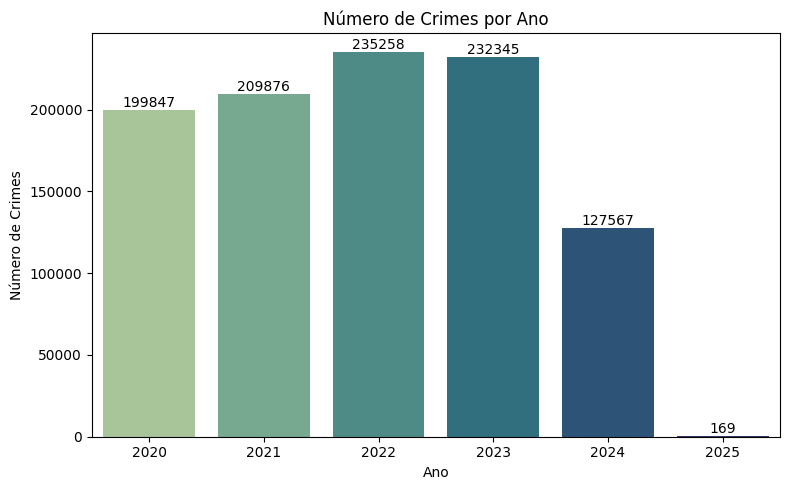

In [14]:
plt.figure(figsize=(8, 5))
ax = sns.countplot(data=df_crimes_tratado, x='ANO OCC', hue='ANO OCC', palette='crest', legend=False)

for p in ax.patches:
    height = p.get_height() # type: ignore
    ax.annotate(
        f'{height:.0f}',
        (p.get_x() + p.get_width() / 2., height), # type: ignore
        ha='center', va='bottom',
        fontsize=10
    )

plt.title('Número de Crimes por Ano')
plt.ylabel('Número de Crimes')
plt.xlabel('Ano')
plt.tight_layout()
plt.show()

Por meio do gráfico, concluí-se que:

- Partindo de 2020, o número de crimes foi crescente até o ano de 2022; a partir desse ano, os casos diminuíram
- O ano com maior número de crimes foi 2022, com uma alta de 235258 casos
- O ano de 2024 foi o ano com menor número de crimes, com apenas 127567 casos (desconsiderando-se 2025 por ser o ano vigente)

2. Por mês (acumulativo)

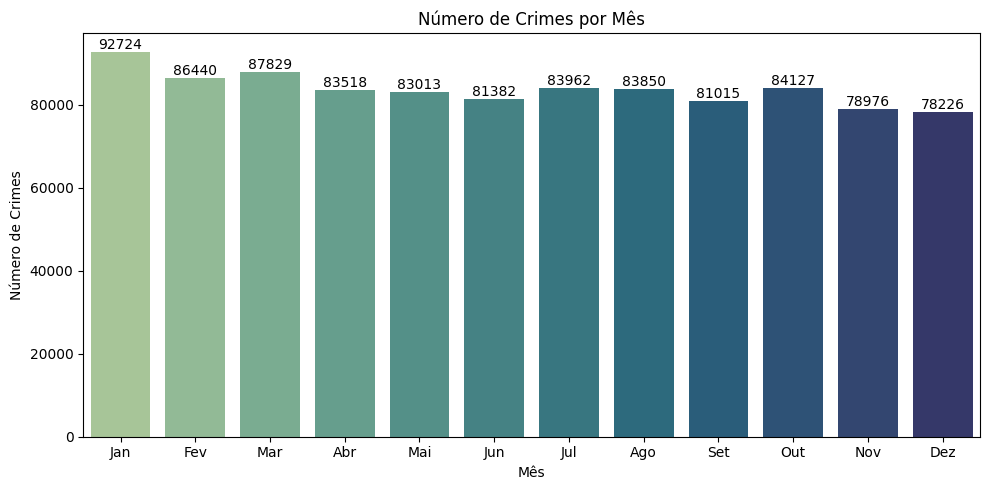

In [15]:
plt.figure(figsize=(10, 5))
ax = sns.countplot(data=df_crimes_tratado, x='MES OCC', hue='MES OCC', palette='crest', legend=False)
for p in ax.patches:
    height = p.get_height() # type: ignore
    ax.annotate(
        f'{height:.0f}',
        (p.get_x() + p.get_width() / 2., height), # type: ignore
        ha='center', va='bottom'
    )
plt.title('Número de Crimes por Mês')
plt.xlabel('Mês')
plt.ylabel('Número de Crimes')
plt.xticks(range(12), [
    'Jan', 'Fev', 'Mar', 'Abr', 'Mai', 'Jun',
    'Jul', 'Ago', 'Set', 'Out', 'Nov', 'Dez'
])
plt.tight_layout()
plt.show()

Por meio do gráfico, concluí-se que:

- A quantidade de crimes possui tendência decrescente com o passar dos meses
- Janeiro foi o mês com mais casos de crimes reportados, com 92724
- Dezembro foi o mês com menor número de casos, 78226

3. Por dia do mês (acumulativo)

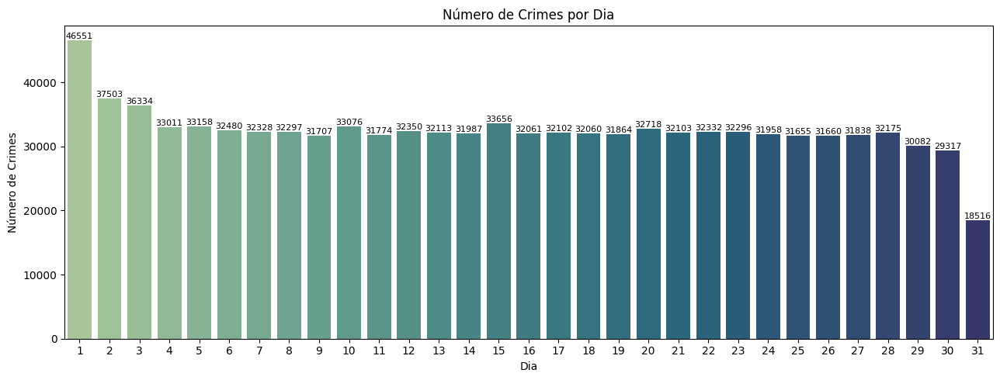

In [16]:
plt.figure(figsize=(13, 5))
ax = sns.countplot(data=df_crimes_tratado, x='DIA OCC', hue='DIA OCC', palette='crest', legend=False)
for p in ax.patches:
    height = p.get_height() # type: ignore
    ax.annotate(
        f'{height:.0f}',
        (p.get_x() + p.get_width() / 2., height), # type: ignore
        ha='center', va='bottom',
        fontsize=8
    )
plt.title('Número de Crimes por Dia')
plt.xlabel('Dia')
plt.ylabel('Número de Crimes')
plt.tight_layout()
plt.show()

Por meio do gráfico, concluí-se que:

- Os crimes estão bem distribuídos ao longo dos meses
- O dia 31 é o dia com menor quantidade de casos (18516) devido aos meses de 30 dias
- O dia 1º possui quantidade anormal de crimes, sendo 46551 casos. Uma hipótese para essa anormalidade é que esse dia pode ser usado para representar casos em que os dias da ocorrência é desconhecido

4. Por dia da semana (acumulativo)

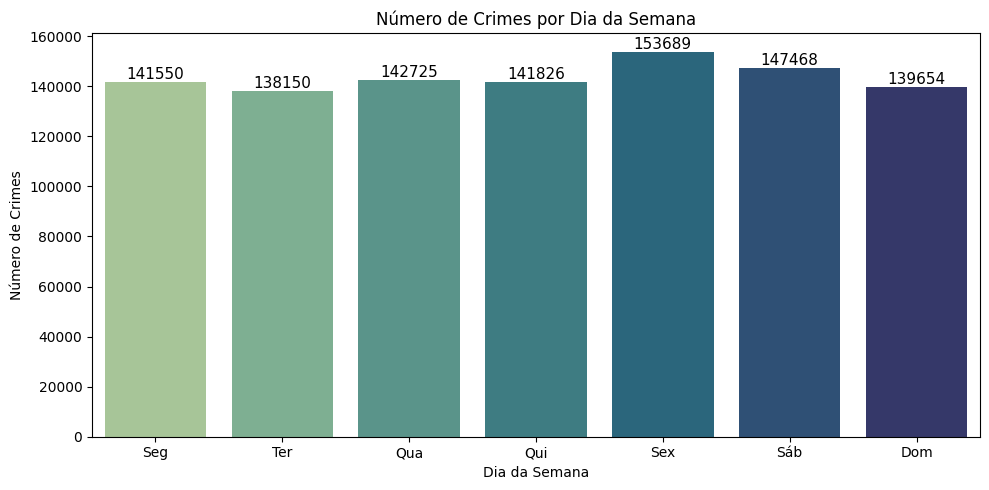

In [17]:
plt.figure(figsize=(10, 5))
ax = sns.countplot(data=df_crimes_tratado, x='DIA SEMANA OCC', hue='DIA SEMANA OCC', palette='crest', legend=False)
for p in ax.patches:
    height = p.get_height() # type: ignore
    ax.annotate(
        f'{height:.0f}',
        (p.get_x() + p.get_width() / 2., height), # type: ignore
        ha='center', va='bottom',
        fontsize=11
    )
plt.title('Número de Crimes por Dia da Semana')
plt.xlabel('Dia da Semana')
plt.ylabel('Número de Crimes')
plt.xticks(range(7), ['Seg', 'Ter', 'Qua', 'Qui', 'Sex', 'Sáb', 'Dom'])
plt.tight_layout()
plt.show()

Por meio do gráfico, concluí-se que:

- A quantidade de crimes é bem distribuída ao longo dos dias da semana
- O dia da semana com maior taxa de crimes é sexta-feira, com 153689 casos
- O dia com o menor número de crimes é terça-feira, com 138150 casos

5. Por hora do dia (acumulativo)

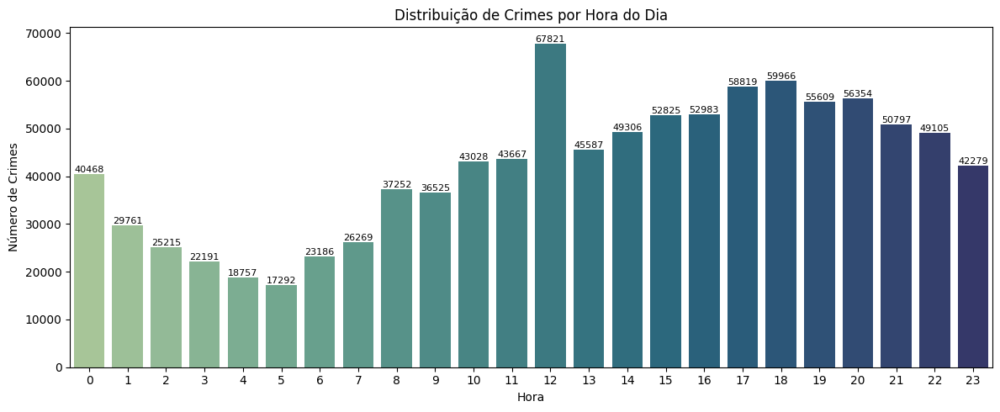

In [18]:
plt.figure(figsize=(12, 5))
ax = sns.countplot(data=df_crimes_tratado, x='HORA OCC', hue='HORA OCC', palette='crest', legend=False)
for p in ax.patches:
    height = p.get_height() # type: ignore
    ax.annotate(
        f'{height:.0f}',
        (p.get_x() + p.get_width() / 2., height), # type: ignore
        ha='center', va='bottom',
        fontsize=8
    )
plt.title('Distribuição de Crimes por Hora do Dia')
plt.xlabel('Hora')
plt.ylabel('Número de Crimes')
plt.tight_layout()
plt.show()

Por meio do gráfico, concluí-se que:

- A distribuição de crimes por hora do dia possui aparência sinoidal, assemelhando-se a uma distribuição normal (ou gaussiana)
- O horário com menor número de crimes registrado é 5 horas da manhã
- O meio-dia (12) foi, de forma anormal, o horário com maior número de ocorrências. Uma hipótese para essa anormalidade é que, assim como o dia 1º na análise de crimes por dia do mês, esse horário pode ser usado para representar casos em que a hora da ocorrência é desconhecida

Por curiosidade, foi construído um gráfico Q-Q para saber se essa distribuição é normal:

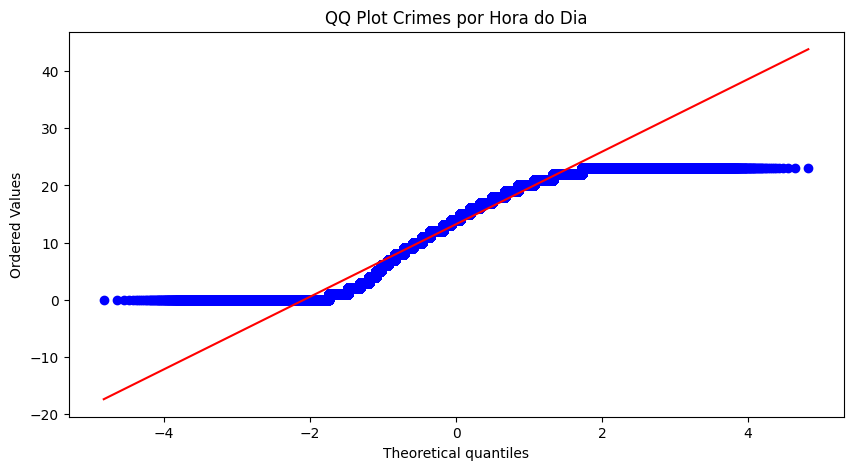

In [19]:
fig_qqplot = plt.figure(figsize=(10,5))
ax_qqplot = plt.axes()
stats.probplot(x=df_crimes_tratado['HORA OCC'], plot=ax_qqplot)
ax_qqplot.set_title('QQ Plot Crimes por Hora do Dia')
fig_qqplot.add_axes(ax_qqplot)
plt.show()

Também foi feito o teste de normalidade de D'Agostino-Pearson para verificar se a distribuição é normal:

In [20]:
def hipotese_nula_rejeitada(normaltest_result):
    if normaltest_result.pvalue < 0.05:
        return True
    return False

dagostino_pearson_hora_crime = stats.normaltest(df_crimes_tratado['HORA OCC'])

print(f"Teste de D'Agostino-Pearson: W = {dagostino_pearson_hora_crime.statistic}, p-valor = {dagostino_pearson_hora_crime.pvalue}")

if hipotese_nula_rejeitada(dagostino_pearson_hora_crime):
    print('Hipótese nula rejeitada!')
else:
    print('Hipótese nula não rejeitada!')

Teste de D'Agostino-Pearson: W = 109077.81687299105, p-valor = 0.0
Hipótese nula rejeitada!


Como evidenciado pelo gráfico e pelo teste de D'Agostino-Pearson, a distribuição de crimes por hora do dia não é normal.

### 2.2.2. Análises geográficas

Após as análises temporais, foi feita uma análise de crimes por região usando `pyplot` e `seaborn` para a criação de gráficos e `folium` para a criação de mapas de calor. A análise deu-se da seguinte forma:

1. Todos os crimes × Área

In [21]:
# Mapa de calor
mapa = folium.Map(location=[34.0522, -118.2437], zoom_start=10)

coordenadas = df_crimes_tratado[['LAT', 'LON']]
coordenadas.dropna()

coordenadas = coordenadas.to_dict()
latitudes = coordenadas['LAT']
longitude = coordenadas['LON']

heat_data = list(zip(latitudes.values(), longitude.values()))

mapa_calor = HeatMap(heat_data, radius=8, blur=12)

mapa.add_child(mapa_calor)

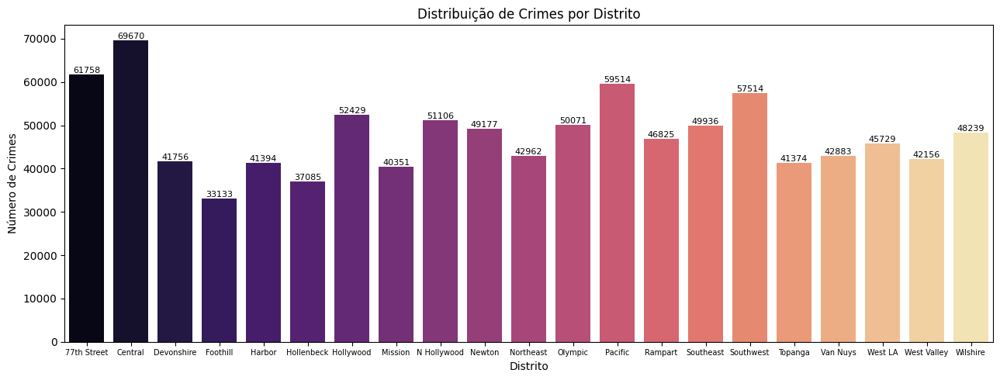

In [22]:
# Gráfico
plt.figure(figsize=(13, 5))
ax = sns.countplot(data=df_crimes_tratado, x='AREA NAME', hue='AREA NAME', palette='magma', legend=False)
for p in ax.patches:
    height = p.get_height() # type: ignore
    ax.annotate(
        f'{height:.0f}',
        (p.get_x() + p.get_width() / 2., height), # type: ignore
        ha='center', va='bottom',
        fontsize=8
    )
plt.title('Distribuição de Crimes por Distrito')
plt.xlabel('Distrito')
plt.xticks(fontsize=7)
plt.ylabel('Número de Crimes')
plt.tight_layout()
plt.show()

2. Assaltos (assaults) × Área

In [23]:
# Mapa de calor
mapa_assaltos = folium.Map(location=[34.0522, -118.2437], zoom_start=10)

filtro_assaltos = df_crimes_tratado['Crm Cd Desc'].str.contains("ASSAULT", case=False, na=False)

coordenadas_assaltos = df_crimes_tratado[filtro_assaltos]

coordenadas_assaltos = coordenadas_assaltos.to_dict()
latitudes_assaltos = coordenadas_assaltos['LAT']
longitude_assaltos = coordenadas_assaltos['LON']

heat_data_assaltos = list(zip(latitudes.values(), longitude.values()))

mapa_calor_assaltos = HeatMap(heat_data_assaltos, radius=8, blur=10)

mapa_assaltos.add_child(mapa_calor_assaltos)

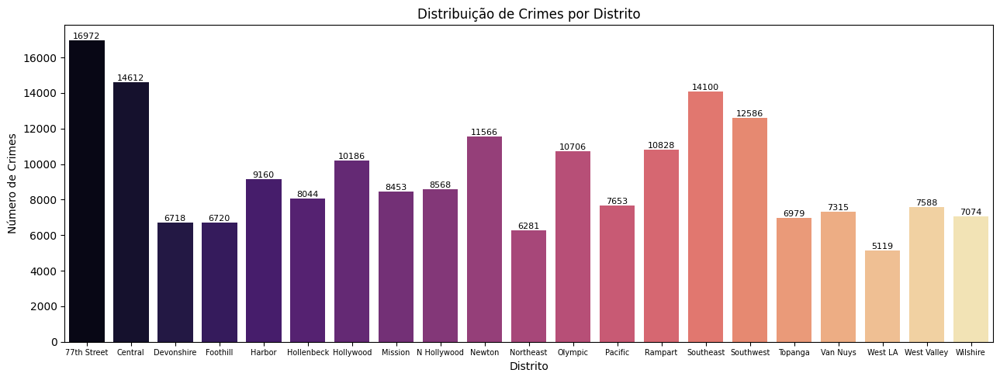

In [24]:
# Gráfico

distritos_assalto = df_crimes_tratado[filtro_assaltos]['AREA NAME']

plt.figure(figsize=(13, 5))
ax = sns.countplot(x=distritos_assalto, hue=distritos_assalto, palette='magma', legend=False)
for p in ax.patches:
    height = p.get_height() # type: ignore
    ax.annotate(
        f'{height:.0f}',
        (p.get_x() + p.get_width() / 2., height), # type: ignore
        ha='center', va='bottom',
        fontsize=8
    )
plt.title('Distribuição de Crimes por Distrito')
plt.xlabel('Distrito')
plt.xticks(fontsize=7)
plt.ylabel('Número de Crimes')
plt.tight_layout()
plt.show()

A partir dos mapas e gráficos, pode-se concluir que as áreas com maior incidência de crimes são "77th Street" e "Central", a primeira localizada na região de South Los Angeles e a segunda sendo a região central da cidade.

### 2.2.3. Análise extras

Por fim, foram feitos mais alguns gráficos usando `pyplot` e `seaborn`:

1. Top 10 Tipos de Crime Mais Comuns

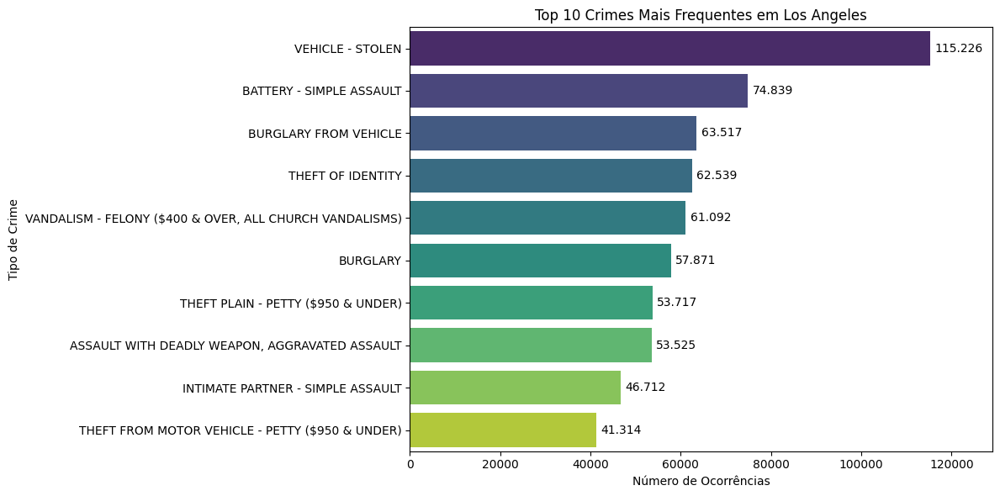

In [25]:
df_top10_crimes = (
    df_crimes_tratado['Crm Cd Desc']
    .value_counts()
    .head(10)
    .reset_index()
    .rename(columns={'Crm Cd Desc': 'Crime', 'count': 'Ocorrências'})
)

df_top10_crimes['Crime'] = pd.Categorical(df_top10_crimes['Crime'], categories=df_top10_crimes['Crime'].tolist(), ordered=True)

plt.figure(figsize=(12, 6))
ax = sns.barplot(data=df_top10_crimes, x='Ocorrências', y='Crime', hue='Crime', palette='viridis', legend=False)

for i, bar in enumerate(ax.patches):
    width = bar.get_width() # type: ignore
    ax.text(
        width + 1000,
        bar.get_y() + bar.get_height() / 2, # type: ignore
        f'{int(width):,}'.replace(',','.'),
        va='center'
    )

max_value = df_top10_crimes['Ocorrências'].max()
plt.xlim(0, max_value * 1.12)
plt.title('Top 10 Crimes Mais Frequentes em Los Angeles')
plt.xlabel('Número de Ocorrências')
plt.ylabel('Tipo de Crime')
plt.tight_layout()
plt.show()


2. Distribuição de crimes por idade da vítima (desconsiderando valores negativos e 0 pelo mesmo motivo dos dias do mês e hora do dia):

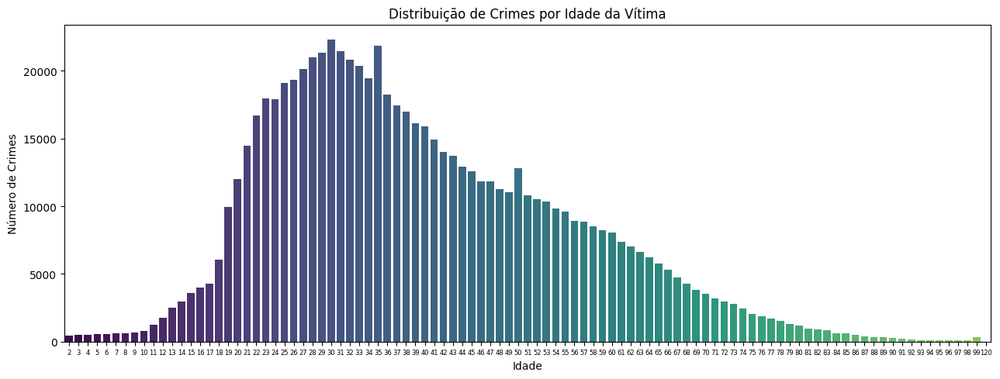

In [26]:
filtro_idade = df_crimes_tratado['Vict Age'] > 0

srs_vict_age_tratado = df_crimes_tratado[filtro_idade]['Vict Age']

plt.figure(figsize=(13, 5))
sns.countplot(x=srs_vict_age_tratado, hue=srs_vict_age_tratado, palette='viridis', legend=False)
plt.title('Distribuição de Crimes por Idade da Vítima')
plt.xlabel('Idade')
plt.xticks(fontsize=6)
plt.ylabel('Número de Crimes')
plt.tight_layout()
plt.show()

3. Distribuição de crimes por sexo da vítima:

C:\Users\felip\AppData\Local\Temp\ipykernel_20224\1263580147.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_vict_sex_tratada['Vict Sex'] = pd.Categorical(df_vict_sex_tratada['Vict Sex'], categories=df_vict_sex_tratada['Vict Sex'].unique().tolist())


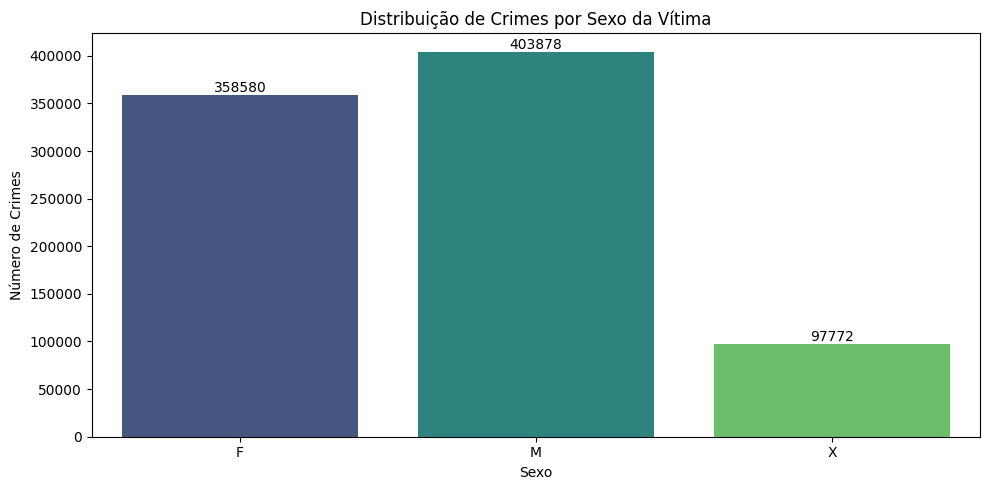

In [27]:
filtro_genero = df_crimes_tratado['Vict Sex'].isin(('M', 'F', 'X'))

df_vict_sex_tratada = df_crimes_tratado[filtro_genero]

df_vict_sex_tratada['Vict Sex'] = pd.Categorical(df_vict_sex_tratada['Vict Sex'], categories=df_vict_sex_tratada['Vict Sex'].unique().tolist())

plt.figure(figsize=(10, 5))
ax = sns.countplot(x=df_vict_sex_tratada['Vict Sex'], hue=df_vict_sex_tratada['Vict Sex'], palette='viridis', legend=False)
for p in ax.patches:
    height = p.get_height() # type: ignore
    ax.annotate(
        f'{height:.0f}',
        (p.get_x() + p.get_width() / 2., height), # type: ignore
        ha='center', va='bottom',
        fontsize=10
    )
plt.title('Distribuição de Crimes por Sexo da Vítima')
plt.xlabel('Sexo')
plt.ylabel('Número de Crimes')
plt.tight_layout()
plt.show()

3. Distribuição de número de crimes por ascendência da vítima

C:\Users\felip\AppData\Local\Temp\ipykernel_20224\22697926.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_vict_descent_tratado['Vict Descent'] = pd.Categorical(df_vict_descent_tratado['Vict Descent'], categories=df_vict_descent_tratado['Vict Descent'].unique().tolist())


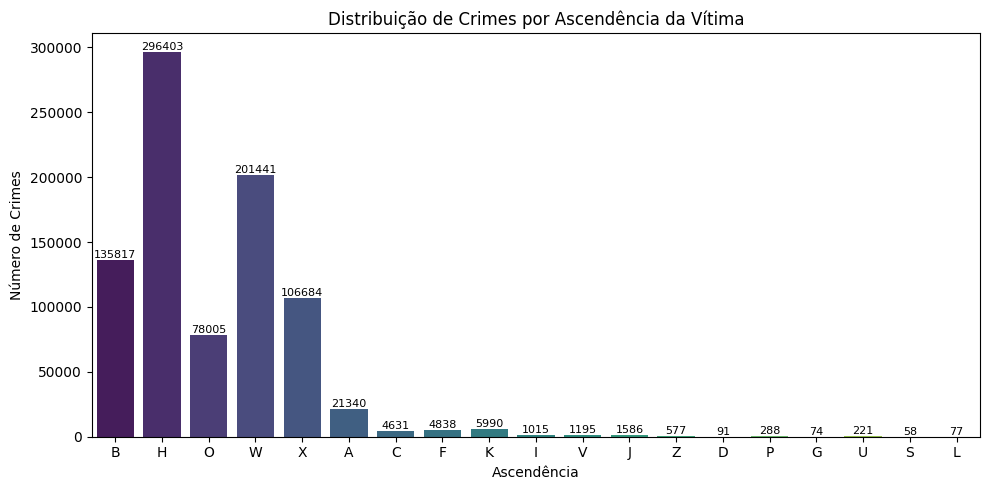

In [28]:
filtro_ascendencia = df_crimes_tratado['Vict Descent'].isin((
    'A', 'B', 'C', 'D', 'F', 'G', 'H', 'I', 'J', 'K', 'L', 'O', 'P', 'S', 'U', 'V', 'W', 'X', 'Z'
))

df_vict_descent_tratado = df_crimes_tratado[filtro_ascendencia]

df_vict_descent_tratado['Vict Descent'] = pd.Categorical(df_vict_descent_tratado['Vict Descent'], categories=df_vict_descent_tratado['Vict Descent'].unique().tolist())

plt.figure(figsize=(10, 5))
ax = sns.countplot(x=df_vict_descent_tratado['Vict Descent'], hue=df_vict_descent_tratado['Vict Descent'], palette='viridis', legend=False)
for p in ax.patches:
    height = p.get_height() # type: ignore
    ax.annotate(
        f'{height:.0f}',
        (p.get_x() + p.get_width() / 2., height), # type: ignore
        ha='center', va='bottom',
        fontsize=8
    )
plt.title('Distribuição de Crimes por Ascendência da Vítima')
plt.xlabel('Ascendência')
plt.ylabel('Número de Crimes')
plt.tight_layout()
plt.show()